In [1]:
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt
from tqdm import tqdm_notebook as tqdm
import os 
os.environ["CUDA_VISIBLE_DEVICES"]="2"
from cifar_model import generator,discriminator
from cifar_model import convnet as cnn
from data import svhn_data
import utils

/home/data/bruno/anaconda3/envs/tf-1.4-env/lib/python3.6/importlib/_bootstrap.py:219: RuntimeWarning: compiletime version 3.5 of module 'tensorflow.python.framework.fast_tensor_util' does not match runtime version 3.6
  return f(*args, **kwds)


In [2]:
'''
build unl data pipeline 
train gan cifar10 kinglsey
generate adv pert
train takeru or simple cnn cifar
get gains !
'''

'\nbuild unl data pipeline \ntrain gan cifar10 kinglsey\ngenerate adv pert\ntrain takeru or simple cnn cifar\nget gains !\n'

In [3]:
params = dict(
    batch_size = 50,
    seed = 1234,
    z_dim = 100,
    lr = 3e-3,
    logdir = 'svhn_gans/',
    name_model = 'model_kingsley'
)
rng = np.random.RandomState(params['seed'])  # seed labels

In [33]:
params_dnn = dict(
    batch=50,
    lr = 3e-3,
    labeled = 50,
    seed = 1234,
    epoch=801
)

In [5]:
def plot_dics(l):
    plt.figure(figsize=(15,5))
    plt.subplot(121)
    names=[]
    for var in ['train','test','ema']:
        for d in l:
            x=d.item().get(var)
            plt.plot(x)
            names.append(var + '_' + d.item().get('name'))
    plt.legend(names)
    plt.subplot(122)
    names=[]
    for var in ['loss','mani']:
        for d in l:
            x=d.item().get(var)
            plt.plot(x)
            names.append(var + '_' + d.item().get('name'))
            plt.legend(names)

## Data

In [6]:
data_dir = '/tmp/data/'
trainx, trainy = svhn_data.load(data_dir, 'train')
testx, testy = svhn_data.load(data_dir, 'test')
def rescale(mat):
    return np.transpose(((-127.5 + mat) / 127.5), (3, 0, 1, 2))
trainx = rescale(trainx)
testx = rescale(testx)

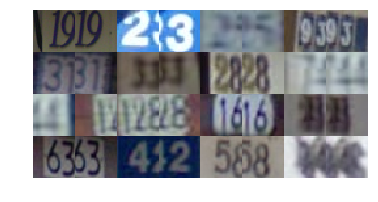

In [7]:
# (trainx, trainy), (testx, testy) = tf.keras.datasets.cifar10.load_data()
# def rescale(mat):
#     return ((-127.5 + mat) / 127.5)
# trainx = rescale(trainx)
# testx = rescale(testx)
# trainy = np.squeeze(trainy)
# testy = np.squeeze(testy)
trainx_unl = trainx.copy()
nr_batch_unl = trainx_unl.shape[0] // params['batch_size']
utils.show_cifar(trainx_unl[:32])

train: (500, 32, 32, 3) test: (26032, 32, 32, 3)


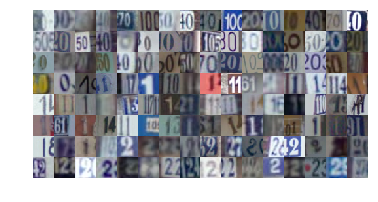

In [8]:
inds = rng.permutation(trainx.shape[0])
trainx = trainx[inds]
trainy = trainy[inds]
txs = []
tys = []
for j in range(10):
    txs.append(trainx[trainy == j][:params_dnn['labeled']])
    tys.append(trainy[trainy == j][:params_dnn['labeled']])
txs = np.concatenate(txs, axis=0)
tys = np.concatenate(tys, axis=0)
trainx = txs
trainy = tys
nr_batch_train = trainx.shape[0] // params_dnn['batch']
nr_batch_test = testx.shape[0] // params_dnn['batch']
print('train:',trainx.shape,'test:',testx.shape)
utils.show_cifar(trainx[:128])

## GAN training

In [9]:
unl = tf.placeholder(tf.float32, [params['batch_size'], 32,32,3])
is_training_pl = tf.placeholder(tf.bool, [], name='is_training_pl')
noise = tf.random_normal(shape=[params['batch_size'],params['z_dim']])

samples = generator(noise,is_training=is_training_pl,reuse=tf.AUTO_REUSE)
real_score = discriminator(unl,is_training=is_training_pl,reuse=tf.AUTO_REUSE)
fake_score = discriminator(samples,is_training=is_training_pl,reuse=tf.AUTO_REUSE)

gen_vars = tf.get_collection(tf.GraphKeys.TRAINABLE_VARIABLES, "generator")
disc_vars = tf.get_collection(tf.GraphKeys.TRAINABLE_VARIABLES, "discriminator") 

loss_g = tf.reduce_mean(tf.nn.sigmoid_cross_entropy_with_logits(logits=fake_score,labels=tf.ones_like(fake_score)))
loss_d = tf.reduce_mean(tf.nn.sigmoid_cross_entropy_with_logits(logits=real_score,labels=tf.ones_like(fake_score)))+\
tf.reduce_mean(tf.nn.sigmoid_cross_entropy_with_logits(logits=fake_score,labels=tf.zeros_like(fake_score)))

optimizer = tf.train.AdamOptimizer(learning_rate=params['lr'], beta1=0.5)

update_ops_gen = tf.get_collection(tf.GraphKeys.UPDATE_OPS, scope='generator')
update_ops_dis = tf.get_collection(tf.GraphKeys.UPDATE_OPS, scope='discriminator')

with tf.control_dependencies(update_ops_gen): # attached op for moving average batch norm
    traing = optimizer.minimize(loss_g,var_list=gen_vars)
with tf.control_dependencies(update_ops_dis):
    traind = optimizer.minimize(loss_d,var_list=disc_vars)

In [10]:
sess = tf.InteractiveSession()
sess.run(tf.global_variables_initializer())

In [23]:
saver = tf.train.Saver()

In [17]:
ls svhn_gan/

checkpoint


In [18]:
path = './svhn_gan/checkpoint'
if tf.train.latest_checkpoint(path) is not None:
    path = saver.restore(sess, tf.train.latest_checkpoint(path))
else:
    print('no model found')

no model found


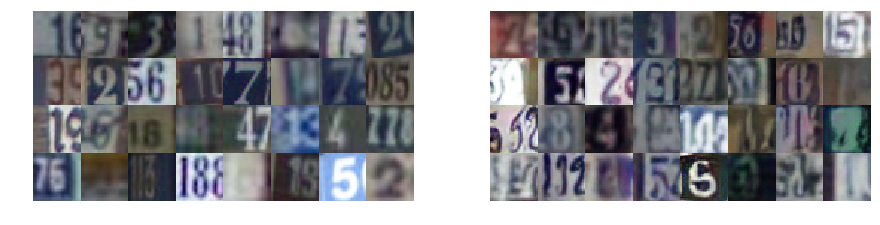

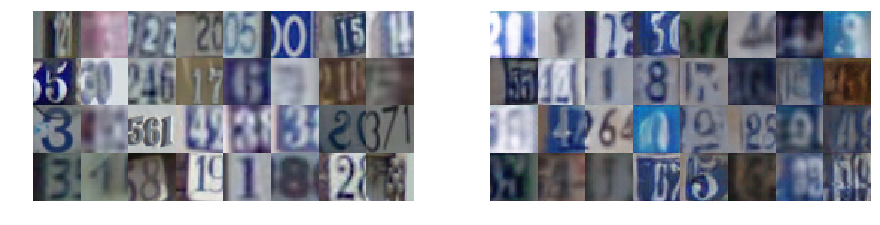

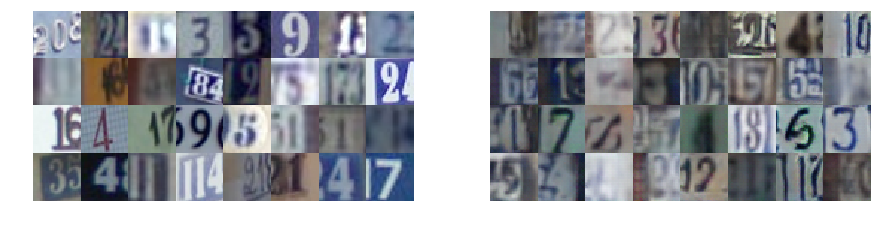

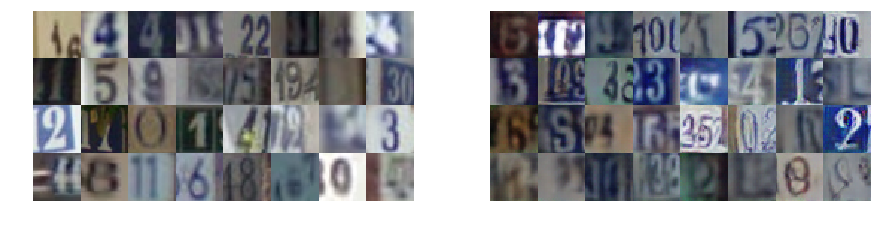

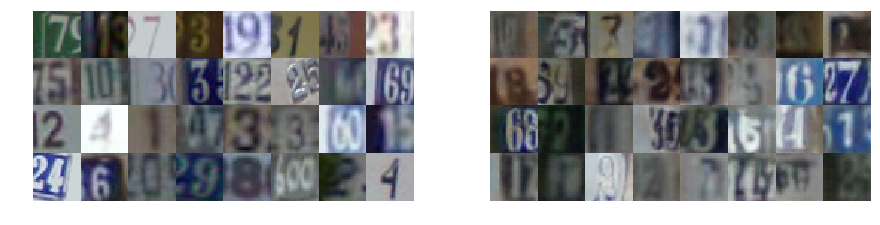

...

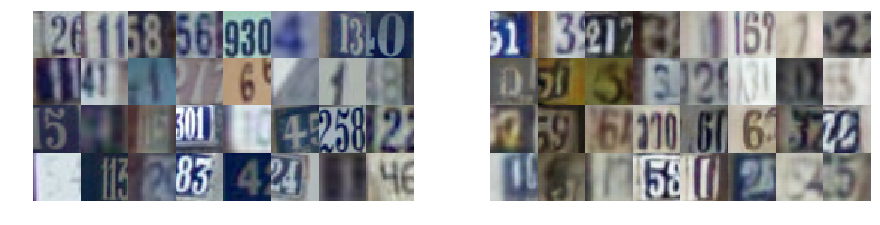

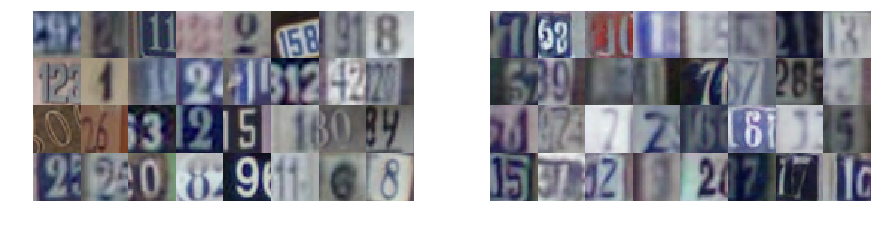

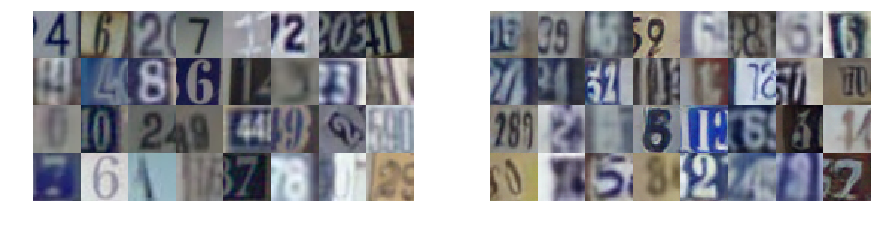

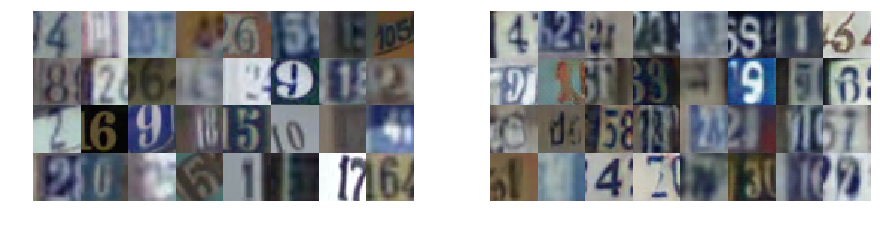

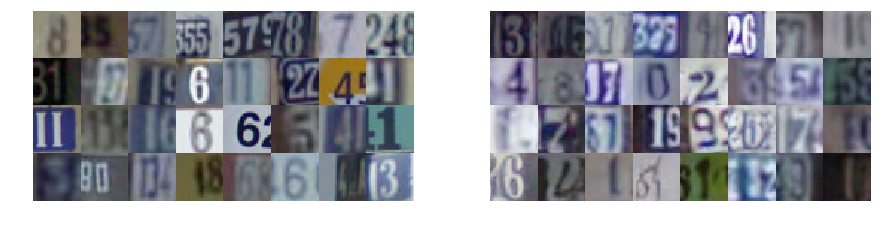

KeyboardInterrupt: 

In [31]:
viz_every = 500
for epoch in tqdm(range(10001)):
    trainx_unl = trainx_unl[rng.permutation(trainx_unl.shape[0])]  # shuffling unl dataset   
    
    for step in range(nr_batch_unl):
        ran_from = step * params['batch_size']
        ran_to = (step + 1) * params['batch_size']
        sess.run(traind,{is_training_pl:True,unl:trainx_unl[ran_from:ran_to]})
        sess.run(traing,{is_training_pl:True,unl:trainx_unl[ran_from:ran_to]})

        if (step) % viz_every == 0:
            xx, yy = sess.run([unl,samples],{is_training_pl:False,unl:trainx_unl[ran_from:ran_to]})
            plt.figure(figsize=(15,5))
            plt.subplot(121)
            utils.show_cifar(xx[:32])
            plt.subplot(122)
            utils.show_cifar(yy[:32])
            plt.show()


In [26]:
# rm svhn_gan/*

In [32]:
saver.save(sess,'./svhn_gan_long/gan_kinglsey')

'./svhn_gan_long/gan_kinglsey'

In [29]:
# saver = tf.train.Saver()

## Vizualization manifold examples

In [40]:
# ############ MANIFOLD ##########
z1 = tf.random_normal(shape=[params['batch_size'],params['z_dim']])
pert_n = tf.nn.l2_normalize(tf.random_normal(shape=[params['batch_size'],params['z_dim']]),dim=[1])
z1_pert = z1 + 1. * pert_n
pz = tf.random_normal([params['batch_size'],32,32,1],stddev=0.2) 

samp_z1 = generator(z1,is_training=is_training_pl,reuse=tf.AUTO_REUSE)
samp_z2 = generator(z1_pert,is_training=is_training_pl,reuse=tf.AUTO_REUSE)
samp_adv = samp_z1 + 10.* tf.nn.l2_normalize(samp_z2-samp_z1,dim=[1,2,3])


In [41]:
xx,yy = sess.run([samp_z1,samp_adv],{is_training_pl:False})
xx = (xx+1.)/2.
yy = (yy+1.)/2.
yy[yy>1.]=1
yy[yy<0]=0

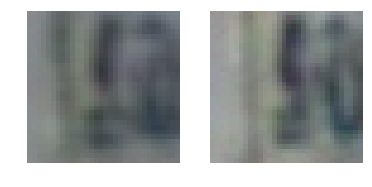

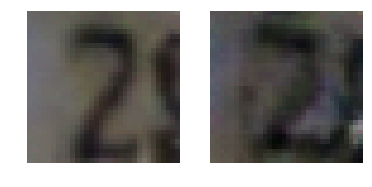

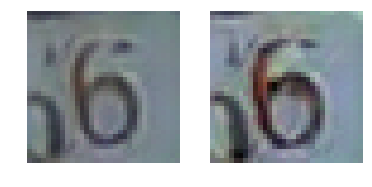

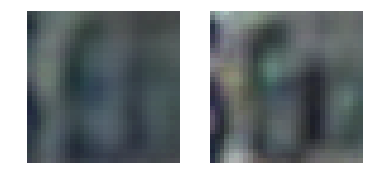

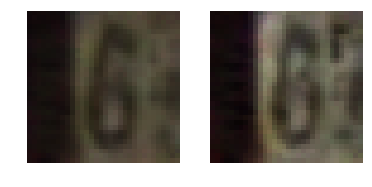

...

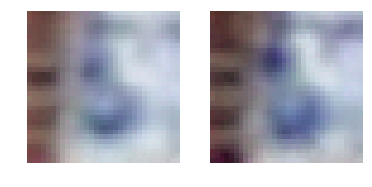

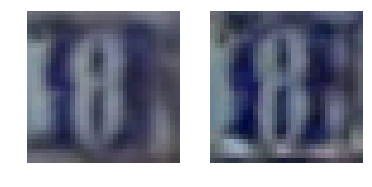

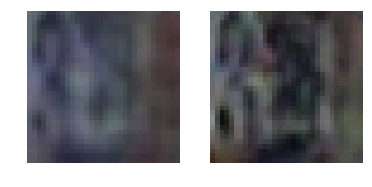

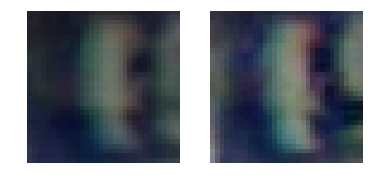

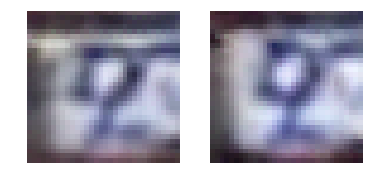

In [42]:
for idx in range(20):
    plt.subplot(1,2,1)
    plt.imshow(np.squeeze(xx[idx]))
    plt.axis('off')
    plt.subplot(1,2,2)
    plt.imshow(np.squeeze(yy[idx]))
    plt.axis('off')
    plt.show()

## Training CNN

In [43]:
inp = tf.placeholder(tf.float32, [params_dnn['batch'], 32,32,3])
lbl = tf.placeholder(tf.int64, [params_dnn['batch']])
# ma_decay = tf.placeholder(tf.float32,[],name='ma_decay_pl')
training_cnn  = tf.placeholder(tf.bool,[])
logits = cnn(inp,training_cnn)
xloss = tf.losses.sparse_softmax_cross_entropy(logits=logits,labels=lbl)

In [44]:
logits_z1= cnn(samp_z1,training_cnn)
logits_z2 = cnn(samp_z2+pz,training_cnn)
logits_adv = cnn(samp_adv,training_cnn) # ADD PZ 

manifold = tf.reduce_sum(tf.sqrt(tf.square(logits_z1-logits_adv)+1e-8),axis=1)
manifold_loss = tf.reduce_mean(manifold)

In [45]:
loss = xloss + 0.005 * manifold_loss

In [46]:
with tf.variable_scope("adam",reuse=tf.AUTO_REUSE):
    global_step = tf.Variable(0, name='global_step',trainable=False)
    optimizer = tf.train.AdamOptimizer(learning_rate=params_dnn['lr'])
    update_ops = tf.get_collection(tf.GraphKeys.UPDATE_OPS,scope='classifier')  # control dependencies for batch norm ops
    with tf.control_dependencies(update_ops):
        train_op = optimizer.minimize(loss,var_list=tf.trainable_variables(scope='classifier'),global_step=global_step)
        
correct_prediction = tf.equal(tf.argmax(logits,1),lbl)
accuracy = tf.reduce_mean(tf.cast(correct_prediction, tf.float32))

In [47]:
ema = tf.train.ExponentialMovingAverage(decay=0.995)
dvars = tf.get_collection(tf.GraphKeys.TRAINABLE_VARIABLES,scope='classifier')
maintain_averages_op = ema.apply(dvars)

with tf.control_dependencies([train_op]):
    train_op = tf.group(maintain_averages_op)

def ema_getter(getter, name, *args, **kwargs):
    var = getter(name, *args, **kwargs)
    ema_var = ema.average(var)
    return ema_var if ema_var else var 
    
logits_ema = cnn(inp, training_cnn, getter=ema_getter)
correct_prediction_ema = tf.equal(tf.argmax(logits_ema,1),lbl)
accuracy_ema = tf.reduce_mean(tf.cast(correct_prediction_ema, tf.float32))

In [48]:
#init
var = tf.global_variables(scope='classifier')+tf.global_variables(scope='adam')
init_op = tf.variables_initializer(var_list=var)

In [49]:
mkdir 'svhn_500lbl/'

mkdir: cannot create directory ‘svhn_500lbl/’: File exists


In [51]:
sess.run(init_op)
name_experiment = './svhn_500lbl/conv_small_g0.005_e20_eta1_long_gan_lr3e-3.npy'
train_array = [];test_array=[]; loss_array=[]; manifold_array=[];test_array_ema=[]

In [ ]:
for epoch in tqdm(range(params_dnn['epoch'])):
    inds = rng.permutation(trainx.shape[0])
    trainx = trainx[inds]
    trainy = trainy[inds]
    train_acc=test_acc=train_loss=train_manifold=test_acc_ema=0
    
    for step in range(nr_batch_train):
        ran_from = step * params_dnn['batch']
        ran_to = (step+1) * params_dnn['batch']
        xl, _ , acc,ml =  sess.run([xloss,train_op, accuracy,manifold_loss], {inp: trainx[ran_from:ran_to],
                                                                             lbl: trainy[ran_from:ran_to],
                                                                             is_training_pl:False,
                                                                             training_cnn:True})
        train_acc += acc; train_loss += xl; train_manifold += ml
    train_acc /= nr_batch_train; train_loss /= nr_batch_train; train_manifold /= nr_batch_train
    train_array.append(train_acc);loss_array.append(train_loss);manifold_array.append(train_manifold)
    for step in range(nr_batch_test):
        ran_from = step * params_dnn['batch']
        ran_to = (step+1) * params_dnn['batch']
        acc,acc_ema = sess.run([accuracy,accuracy_ema], {inp: testx[ran_from:ran_to],
                                         lbl: testy[ran_from:ran_to],
                                         training_cnn:False})
        test_acc += acc; test_acc_ema += acc_ema
    test_acc /= nr_batch_test; test_acc_ema /=nr_batch_test
    test_array.append(test_acc);test_array_ema.append(test_acc_ema)
    
    print("Epoch: {},global_stp: {}, xloss: {:.5f}, maniloss: {:.5f}, train: {:.2f}%, test: {:.2f},test_ma: {:.2f}%".format(
            epoch, sess.run(global_step),train_loss, train_manifold,train_acc * 100,test_acc*100, test_acc_ema*100))
    
    if  (epoch % 10 == 0):
        np.save(name_experiment,{'train': train_array,
        'test' : test_array,
        'ema' : test_array_ema,
        'loss' : loss_array,
        'mani' : manifold_array,
        'name':name_experiment})
        
        plot_dics([np.load(name_experiment)])
        plt.show()

In [53]:
nr_batch_train

10